In [2]:
import os
from pathlib import Path

import matplotlib.pyplot as plt

from corebreakout import defaults
from corebreakout import CoreSegmenter
from corebreakout.datasets import PolygonDataset

In [3]:
test_dataset = PolygonDataset()
test_dataset.collect_annotated_images(defaults.DATASET_DIR, 'test')
test_dataset.prepare()

print(test_dataset)


 PolygonDataset
Image count : 5
Class count : 3
  0. BG                                                
  1. col                                               
  2. tray                                              


In [4]:
test_imgs = [test_dataset.load_image(i) for i in test_dataset.image_ids]

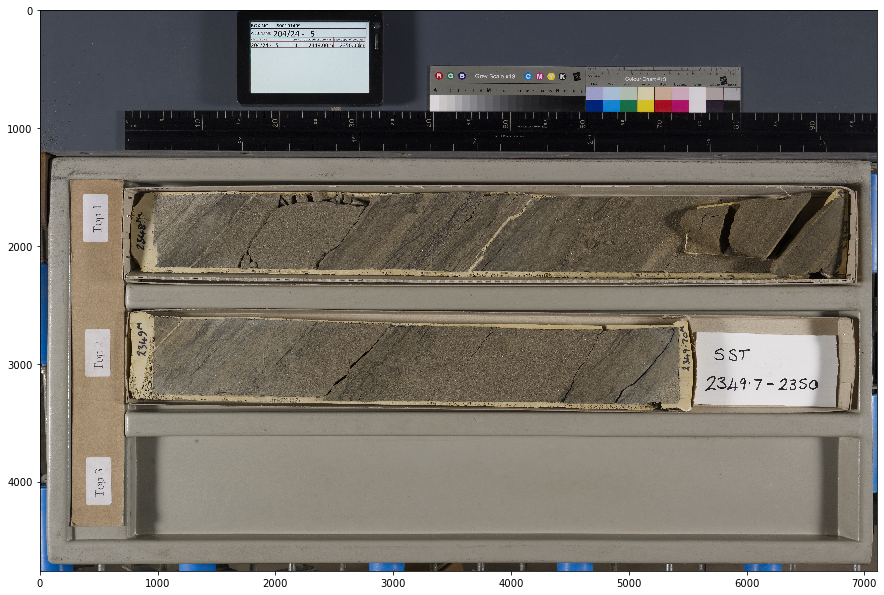

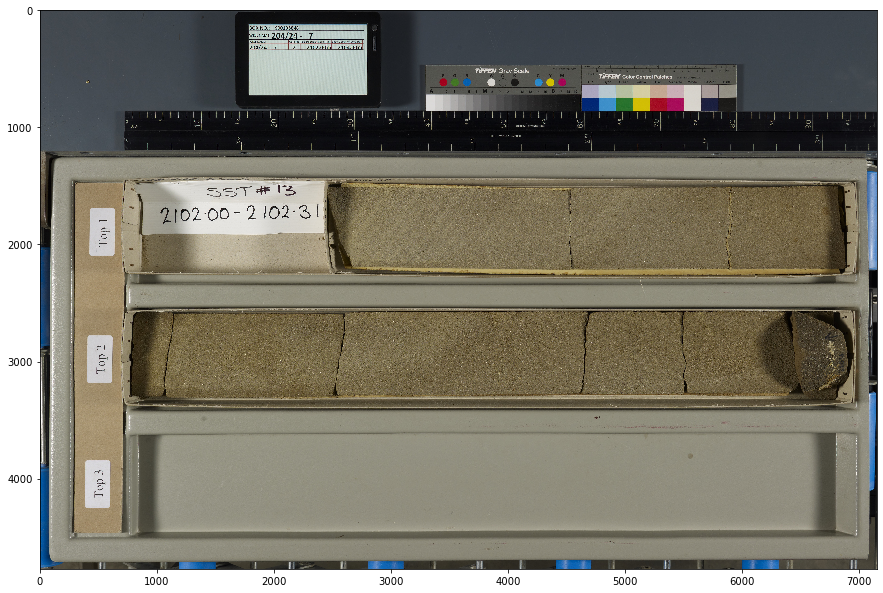

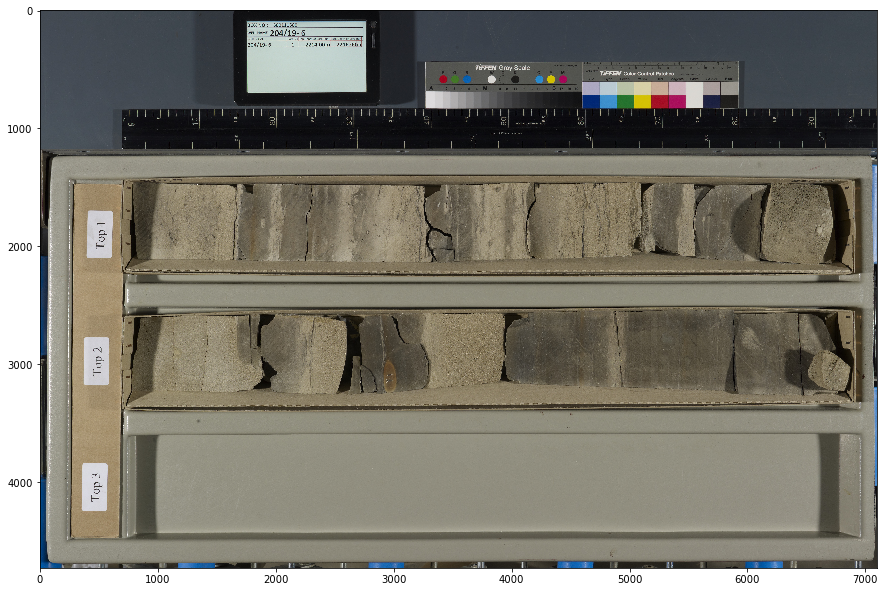

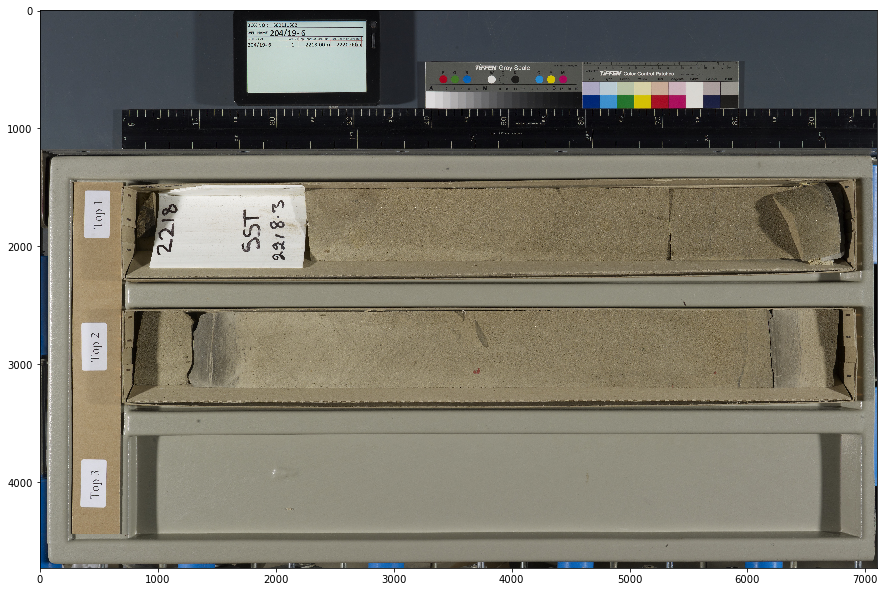

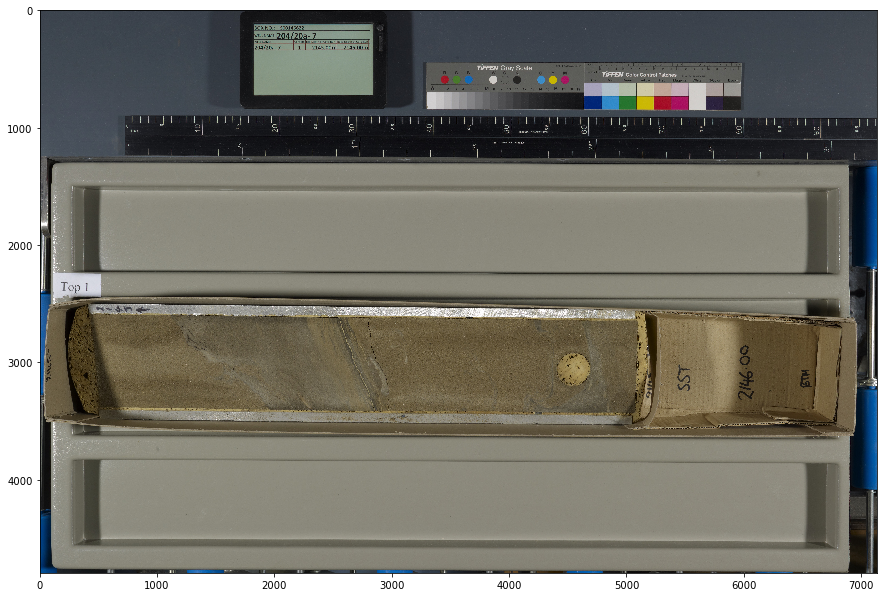

In [5]:
for img in test_imgs:
    fig, ax = plt.subplots(figsize=(15,15))
    ax.imshow(img)

In [6]:
depth_ranges = [(1.0, 3.0) for _ in range(4)] + [(1.0, 2.0)]
depth_ranges

[(1.0, 3.0), (1.0, 3.0), (1.0, 3.0), (1.0, 3.0), (1.0, 2.0)]

In [7]:
model_dir = defaults.TRAIN_DIR / 'cb_default20191104T1443'

candidate_epochs = [30, 48, 63]

Building MRCNN model from directory: /home/ross/Dropbox/models/corebreakout/retrain/cb_default20191104T1443
Loading model weights from file: /home/ross/Dropbox/models/corebreakout/retrain/cb_default20191104T1443/mask_rcnn_cb_default_0030.h5
Re-starting from epoch 30

Testing epoch: 30



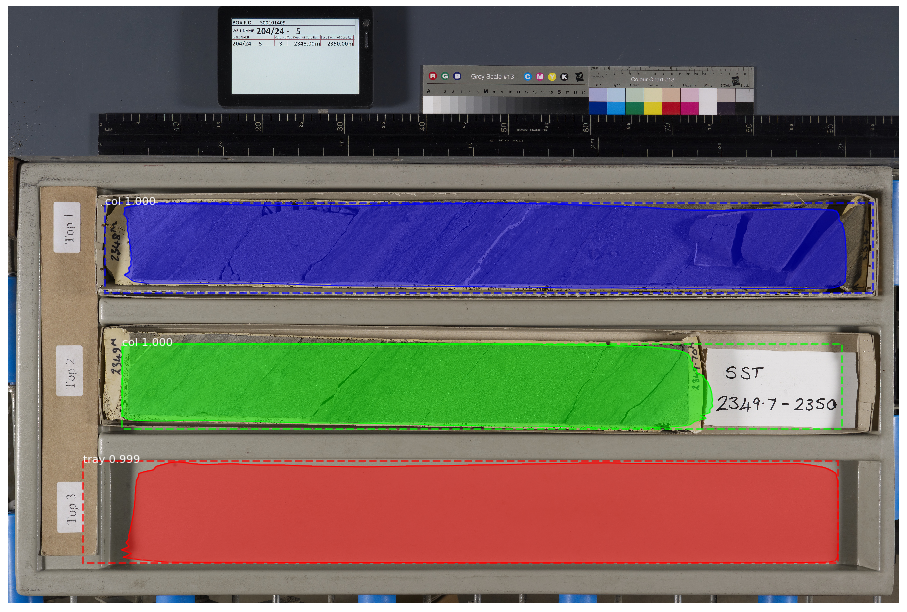

(1.0, 2.0)  +  (2.0, 3.0)  gap:  0.0


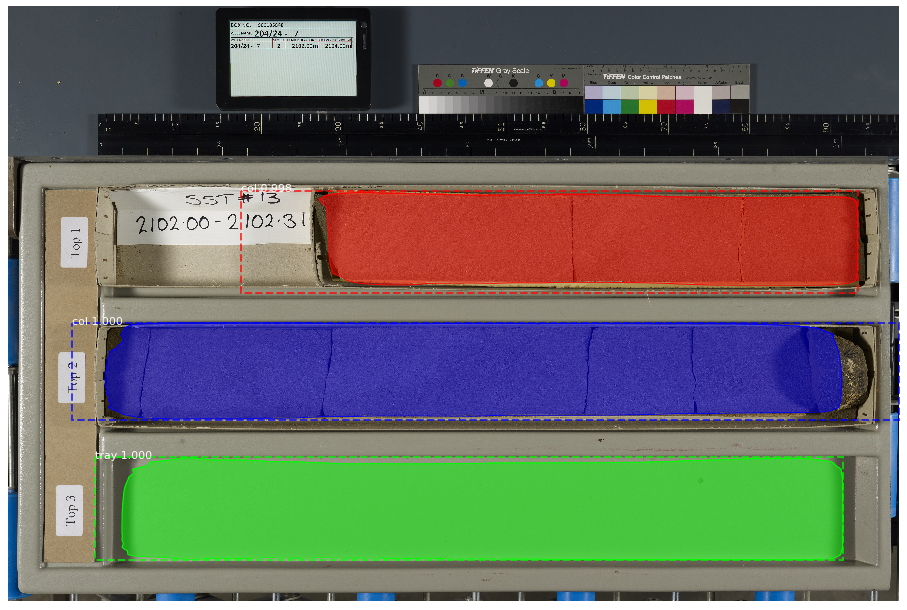

(1.0, 2.0)  +  (2.0, 3.0)  gap:  0.0


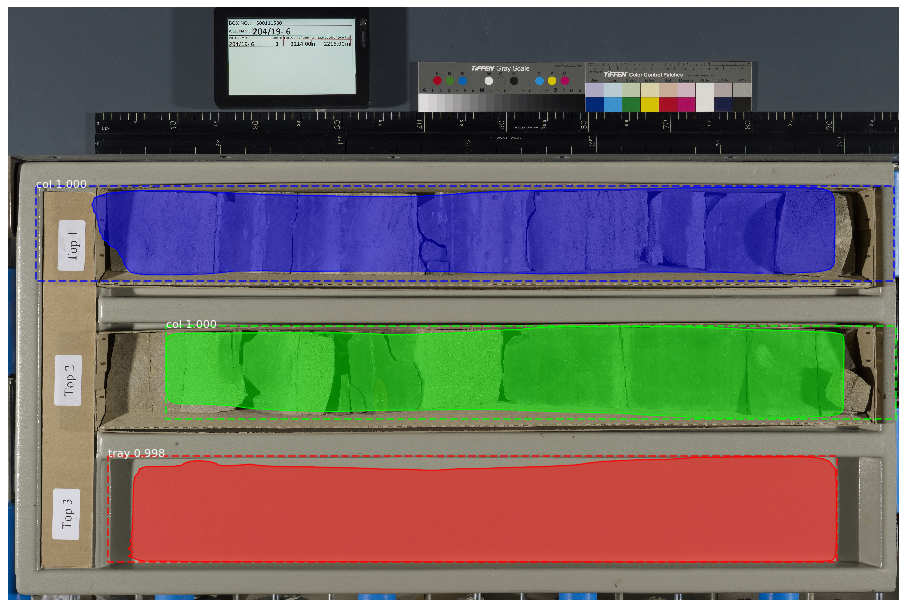

(1.0, 2.0)  +  (2.0, 3.0)  gap:  0.0


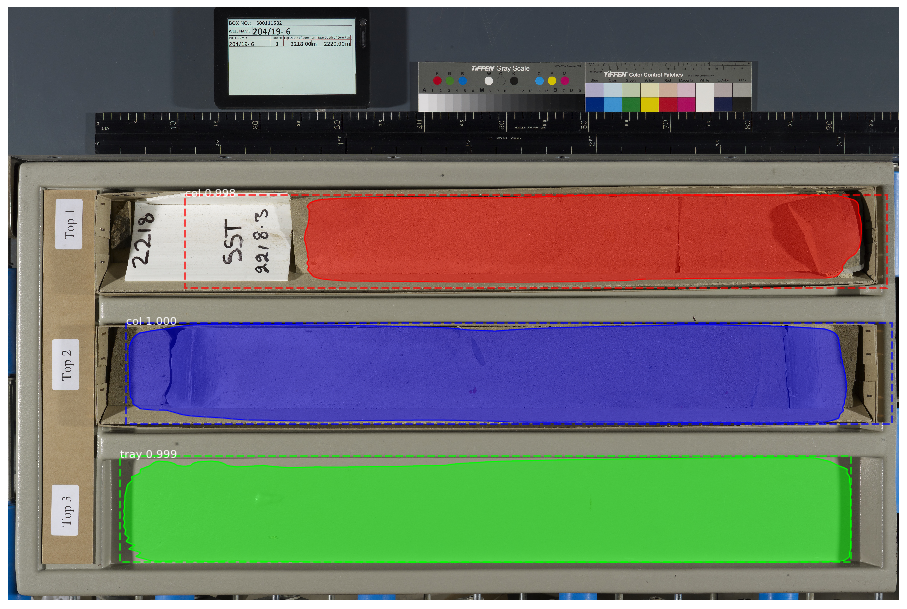

(1.0, 2.0)  +  (2.0, 3.0)  gap:  0.0


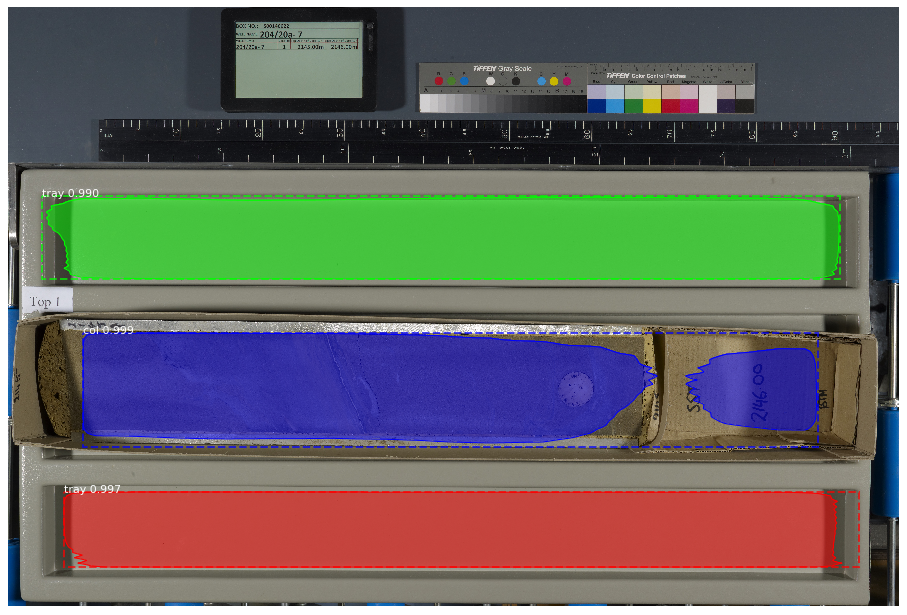

Building MRCNN model from directory: /home/ross/Dropbox/models/corebreakout/retrain/cb_default20191104T1443
Loading model weights from file: /home/ross/Dropbox/models/corebreakout/retrain/cb_default20191104T1443/mask_rcnn_cb_default_0048.h5
Re-starting from epoch 48

Testing epoch: 48



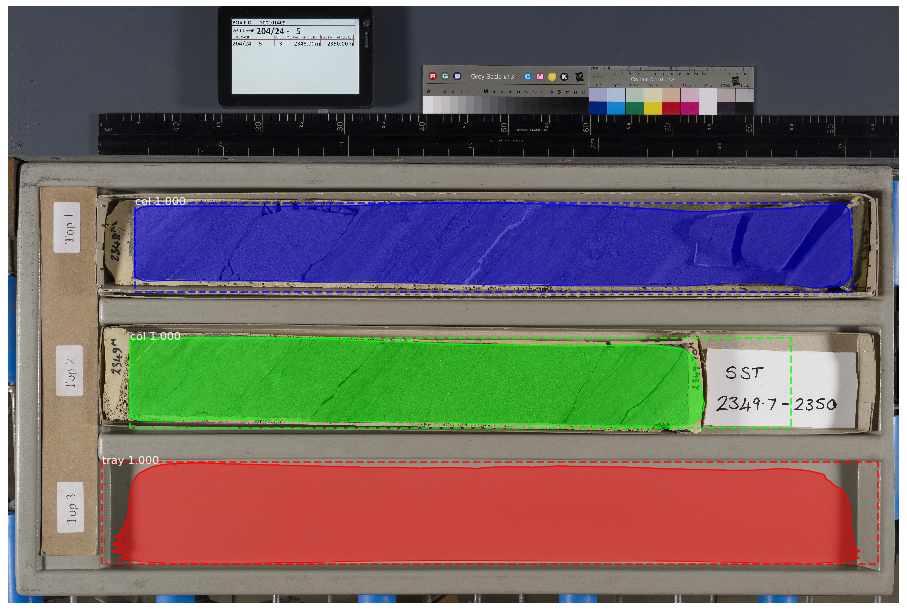

(1.0, 2.0)  +  (2.0, 3.0)  gap:  0.0


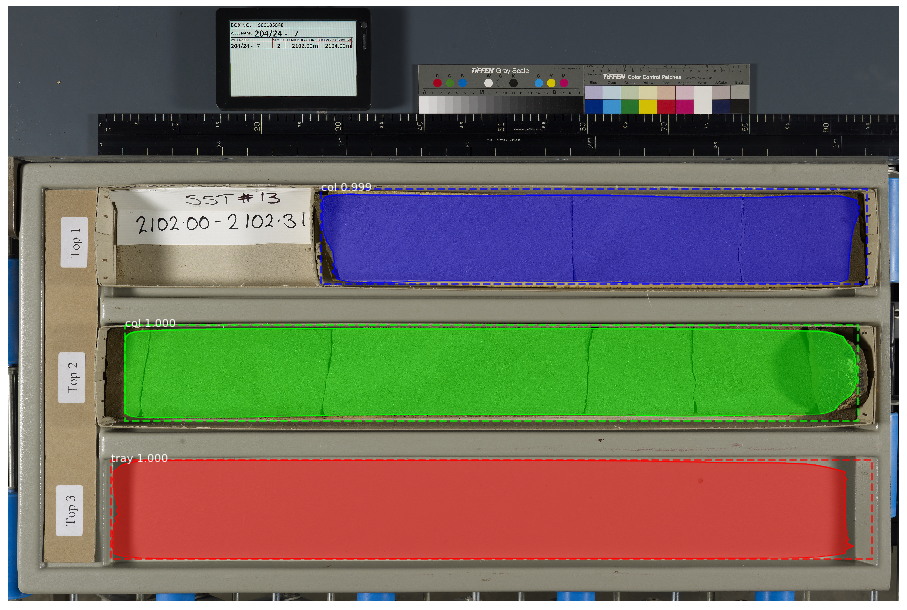

(1.0, 2.0)  +  (2.0, 3.0)  gap:  0.0


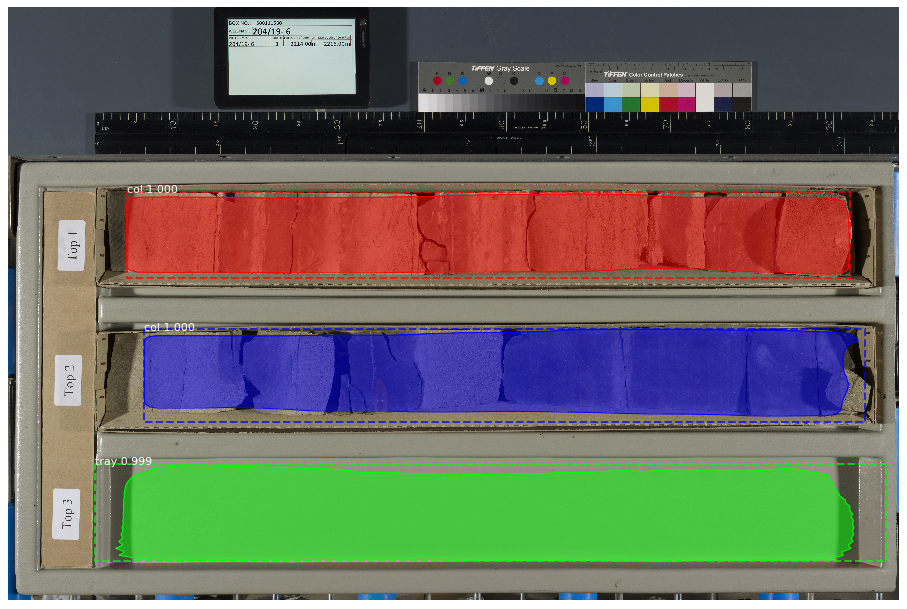

(1.0, 2.0)  +  (2.0, 3.0)  gap:  0.0


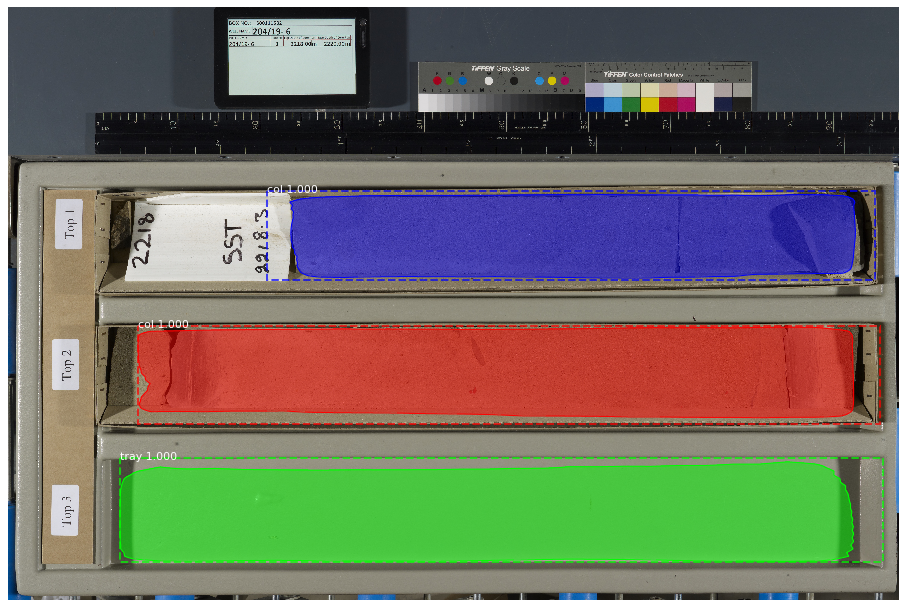

(1.0, 2.0)  +  (2.0, 3.0)  gap:  0.0


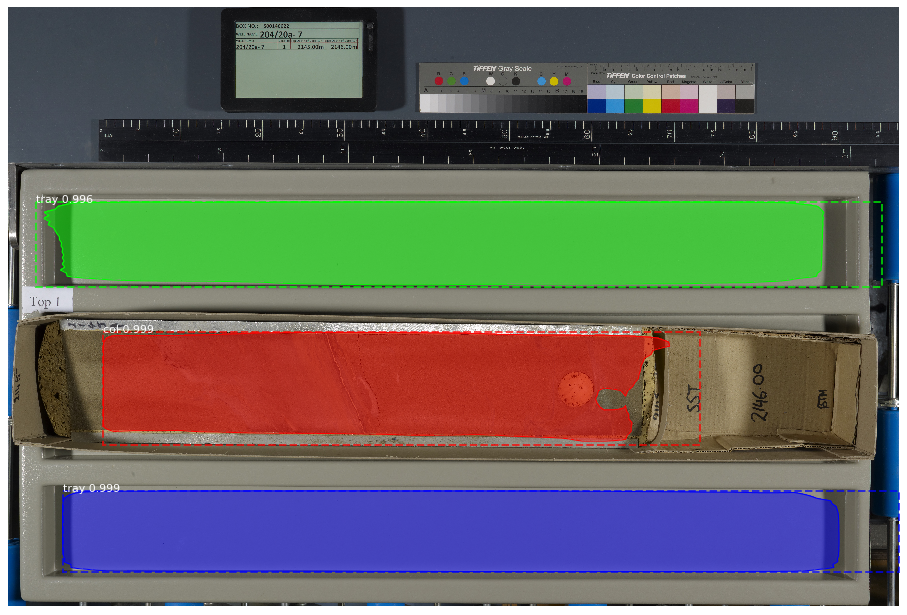

Building MRCNN model from directory: /home/ross/Dropbox/models/corebreakout/retrain/cb_default20191104T1443
Loading model weights from file: /home/ross/Dropbox/models/corebreakout/retrain/cb_default20191104T1443/mask_rcnn_cb_default_0063.h5
Re-starting from epoch 63

Testing epoch: 63



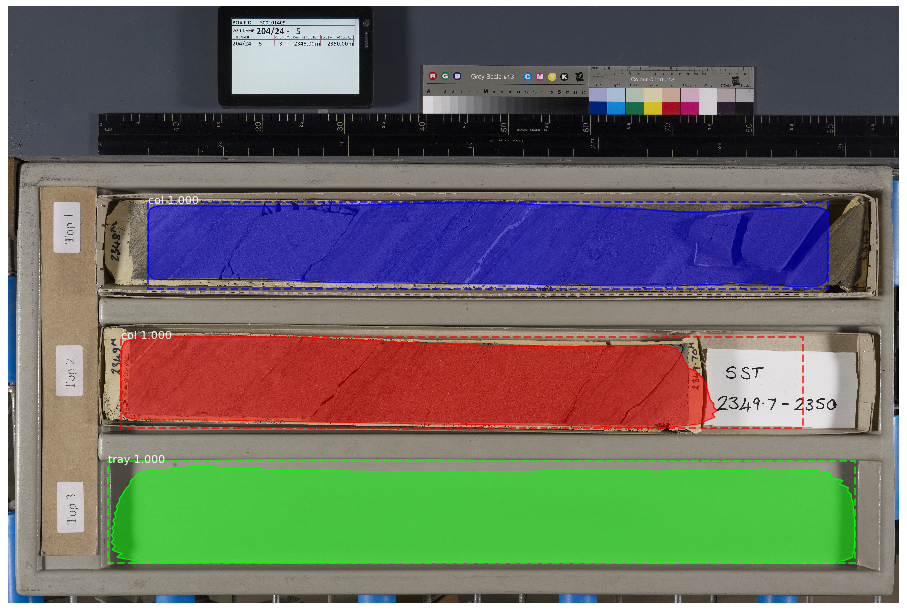

(1.0, 2.0)  +  (2.0, 3.0)  gap:  0.0


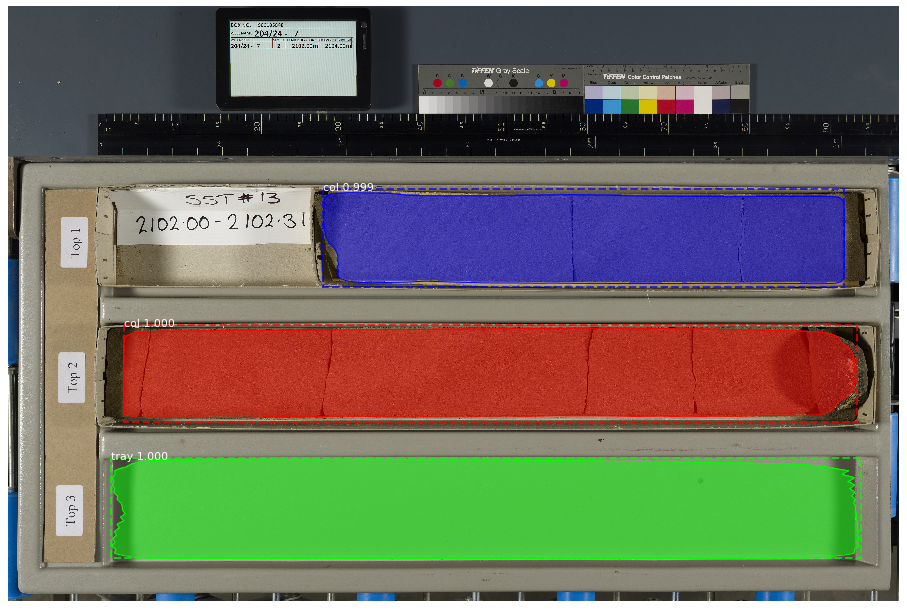

(1.0, 2.0)  +  (2.0, 3.0)  gap:  0.0


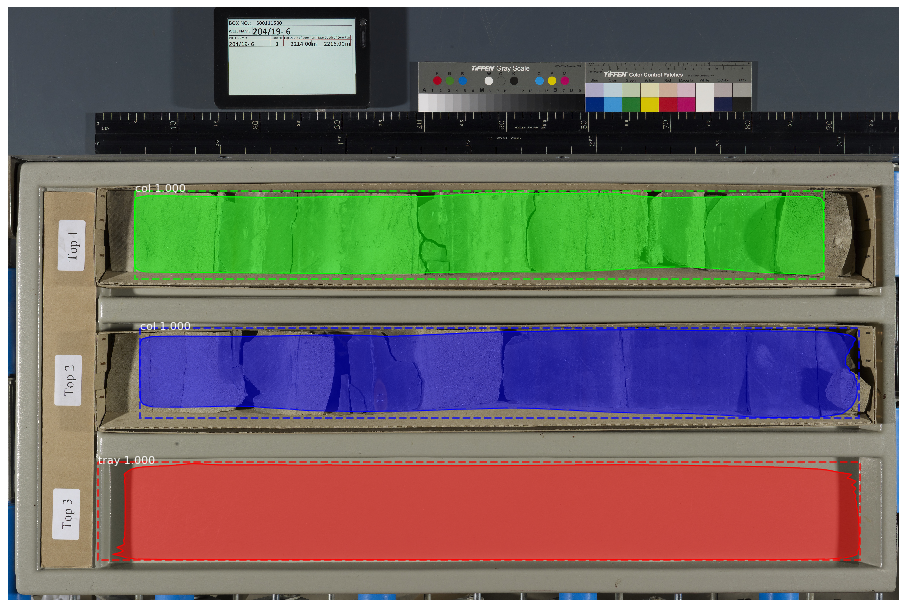

(1.0, 2.0)  +  (2.0, 3.0)  gap:  0.0


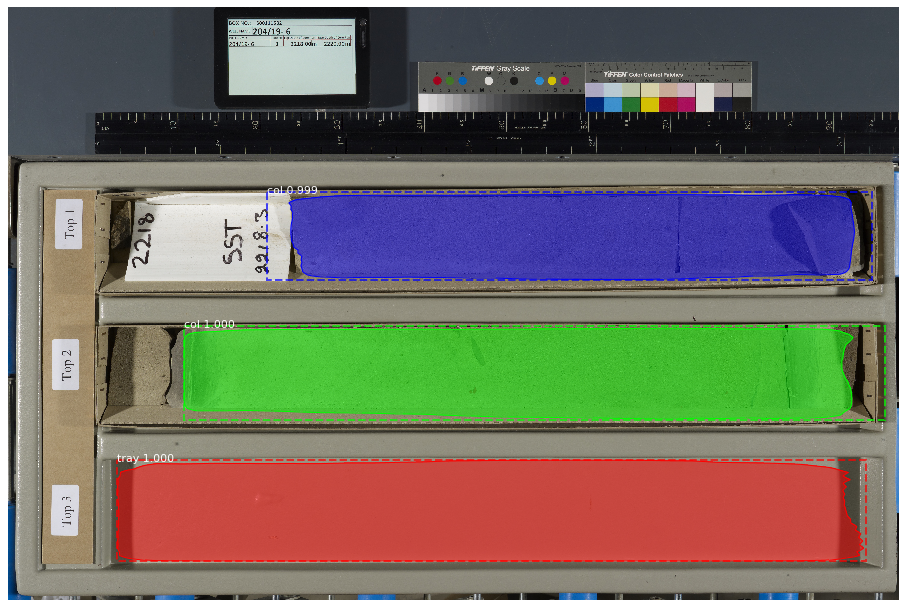

(1.0, 2.0)  +  (2.0, 3.0)  gap:  0.0


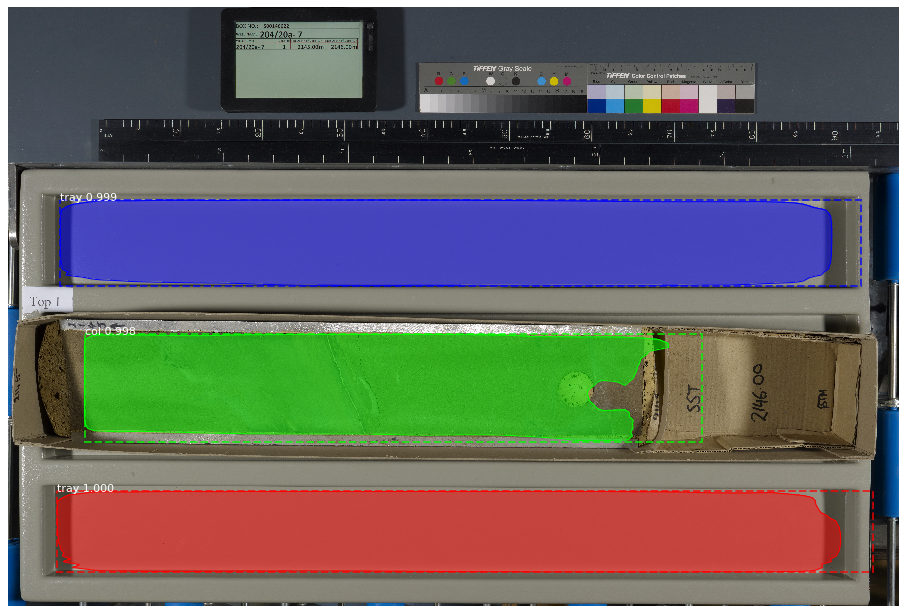

In [9]:
for e in candidate_epochs:
    
    weights_path = model_dir / 'mask_rcnn_cb_default_{:04d}.h5'.format(e)
    
    segmenter = CoreSegmenter(model_dir, weights_path)
    
    print(f'\nTesting epoch: {e}\n')
    
    for img, depth_range in zip(test_imgs, depth_ranges):
        col = segmenter.segment(img, depth_range, show=True)

In [8]:
new_candidate_epochs = [59]

for e in new_candidate_epochs:
    
    weights_path = model_dir / 'mask_rcnn_cb_default_{:04d}.h5'.format(e)
    
    segmenter = CoreSegmenter(model_dir, weights_path)
    
    print(f'\nTesting epoch: {e}\n')
    
    for img, depth_range in zip(test_imgs, depth_ranges):
        col = segmenter.segment(img, depth_range, show=True)

Building MRCNN model from directory: /home/ross/Dropbox/core_data/saved_models/mrcnn/latest/core20180920T1528
Loading model weights from file: /home/ross/Dropbox/core_data/saved_models/mrcnn/latest/core20180920T1528/mask_rcnn_cb_default_0059.h5


OSError: Unable to open file (unable to open file: name = '/home/ross/Dropbox/core_data/saved_models/mrcnn/latest/core20180920T1528/mask_rcnn_cb_default_0059.h5', errno = 2, error message = 'No such file or directory', flags = 0, o_flags = 0)

In [ ]:
test_dataset = PolygonDataset()
test_dataset.collect_annotated_images(defaults.DATASET_DIR, 'test')
test_dataset.prepare()

print(test_dataset)

In [ ]:
test_img = test_dataset.load_image(2)

fig, ax = plt.subplots(figsize=(25,25))
ax.imshow(test_img)

In [ ]:
column = segmenter.segment(test_img, [2102.,2104.], show=True)

In [ ]:
fig.savefig('/home/ross/Pictures/stacked_column.png')